<a href="https://colab.research.google.com/github/tpalczew/presentation-support/blob/main/presentation_support.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
def check_gpu():
  '''
  A simple function to check GPU existence and type
  You can simple do nvidia-smi
  '''
  import locale
  locale.getpreferredencoding = lambda: "UTF-8"
  gpu_info = !nvidia-smi
  gpu_info = '\n'.join(gpu_info)
  if gpu_info.find('failed') >= 0:
    print('Not connected to a GPU')
  else:
    print(gpu_info)

In [ ]:
check_gpu()

Mon May 22 04:29:50 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 525.85.12    Driver Version: 525.85.12    CUDA Version: 12.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  NVIDIA A100-SXM...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   34C    P0    45W / 400W |      0MiB / 40960MiB |      0%      Default |
|                               |                      |             Disabled |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# Install requirements 

In [ ]:
!pip3 install -r /content/drive/MyDrive/Data/requirements.txt

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Cloning https://github.com/facebookresearch/segment-anything.git to /tmp/pip-req-build-2qv3ube9
  Running command git clone --filter=blob:none --quiet https://github.com/facebookresearch/segment-anything.git /tmp/pip-req-build-2qv3ube9
  Resolved https://github.com/facebookresearch/segment-anything.git to commit 6fdee8f2727f4506cfbbe553e23b895e27956588
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 934.9/934.9 kB 47.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 19.9/19.9 MB 81.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.1/7.1 MB 113.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.5/1.5 MB 93.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 81.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 219.1/219.1 kB 28.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━

In [ ]:
import diffusers
print( diffusers.__version__)

0.16.1


In [ ]:
from diffusers.utils import load_image
from PIL import Image
import cv2
import numpy as np
from diffusers.utils import load_image
from diffusers import StableDiffusionControlNetPipeline, ControlNetModel, UniPCMultistepScheduler
import torch
from segment_anything import sam_model_registry
from segment_anything import SamAutomaticMaskGenerator
import supervision as sv
import matplotlib.pyplot as plt
from diffusers import StableDiffusionInstructPix2PixPipeline, EulerAncestralDiscreteScheduler
import gradio as gr
from clip_interrogator import Config, Interrogator
from diffusers import StableDiffusionInpaintPipeline
from diffusers import DiffusionPipeline

In [ ]:
image_path = "/content/drive/MyDrive/Data/car-roundabout/00000.jpg"

In [ ]:
image = load_image(image_path)

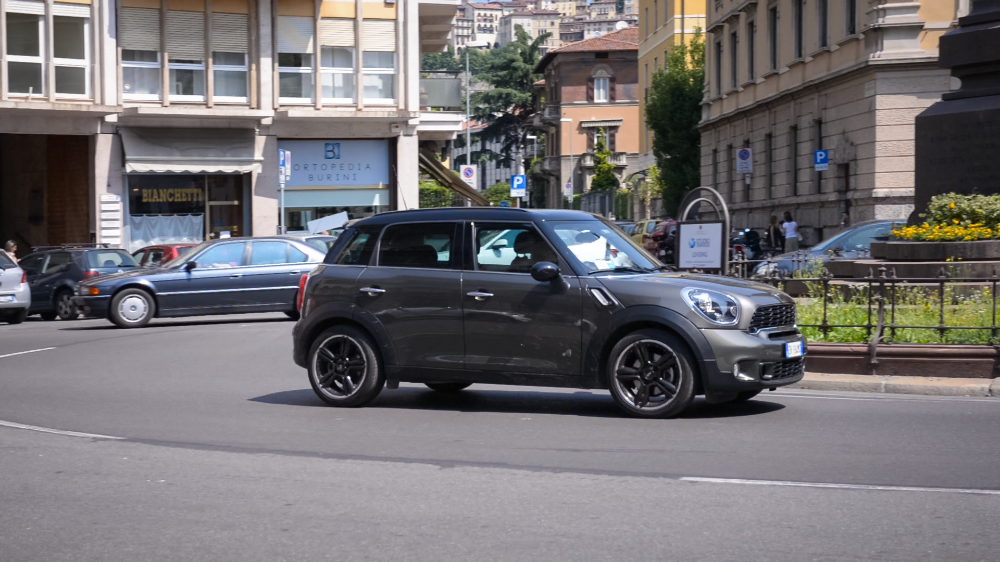

In [ ]:
image

In [ ]:
image.size

(1920, 1080)

In [ ]:
image_np = np.array(image)

In [ ]:
low_threshold = 100
high_threshold = 200
canny_image_np = cv2.Canny(image_np, low_threshold, high_threshold)

In [ ]:
canny_image_np

array([[  0,   0, 255, ...,   0,   0,   0],
       [  0,   0, 255, ...,   0,   0,   0],
       [  0,   0, 255, ...,   0,   0,   0],
       ...,
       [  0,   0,   0, ...,   0,   0,   0],
       [  0,   0,   0, ...,   0,   0,   0],
       [  0,   0,   0, ...,   0,   0,   0]], dtype=uint8)

In [ ]:
image_cn = canny_image_np[:, :, None]
image_cn = np.concatenate([image_cn, image_cn, image_cn], axis=2)
image_cn = Image.fromarray(image_cn)

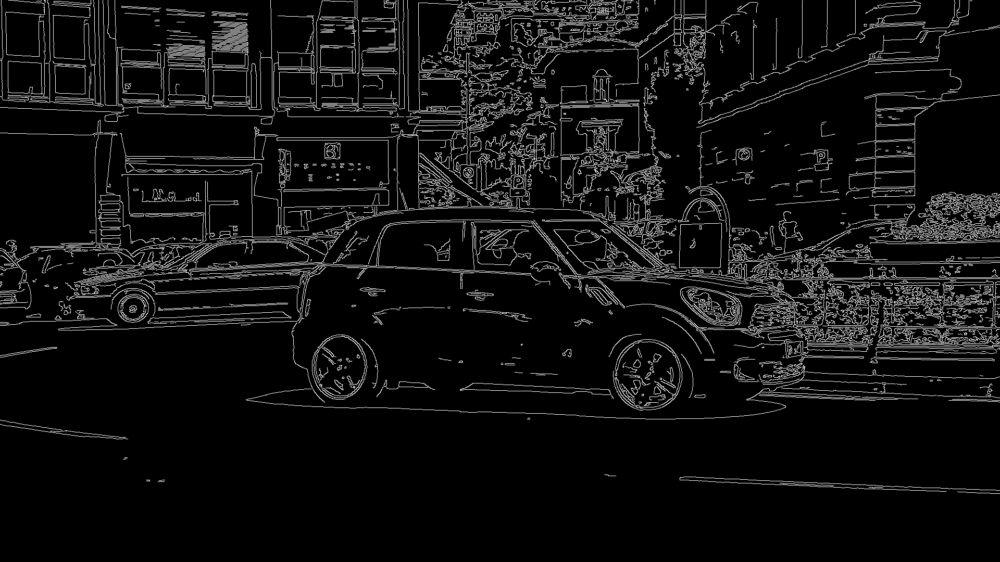

In [ ]:
image_cn

In [ ]:
image_cn.size

(1920, 1080)

In [ ]:
controlnet = ControlNetModel.from_pretrained("lllyasviel/sd-controlnet-canny", torch_dtype=torch.float16)
CN_pipe = StableDiffusionControlNetPipeline.from_pretrained("runwayml/stable-diffusion-v1-5", controlnet=controlnet, safety_checker=None, torch_dtype=torch.float16)
CN_pipe.scheduler = UniPCMultistepScheduler.from_config(CN_pipe.scheduler.config)

You have disabled the safety checker for <class 'diffusers.pipelines.stable_diffusion.pipeline_stable_diffusion_controlnet.StableDiffusionControlNetPipeline'> by passing `safety_checker=None`. Ensure that you abide to the conditions of the Stable Diffusion license and do not expose unfiltered results in services or applications open to the public. Both the diffusers team and Hugging Face strongly recommend to keep the safety filter enabled in all public facing circumstances, disabling it only for use-cases that involve analyzing network behavior or auditing its results. For more information, please have a look at https://github.com/huggingface/diffusers/pull/254 .


In [ ]:
CN_pipe.to('cuda')

StableDiffusionControlNetPipeline {
  "_class_name": "StableDiffusionControlNetPipeline",
  "_diffusers_version": "0.16.1",
  "controlnet": [
    "diffusers",
    "ControlNetModel"
  ],
  "feature_extractor": [
    "transformers",
    "CLIPImageProcessor"
  ],
  "requires_safety_checker": true,
  "safety_checker": [
    null,
    null
  ],
  "scheduler": [
    "diffusers",
    "UniPCMultistepScheduler"
  ],
  "text_encoder": [
    "transformers",
    "CLIPTextModel"
  ],
  "tokenizer": [
    "transformers",
    "CLIPTokenizer"
  ],
  "unet": [
    "diffusers",
    "UNet2DConditionModel"
  ],
  "vae": [
    "diffusers",
    "AutoencoderKL"
  ]
}

In [ ]:
CN_generator = torch.manual_seed(0)

In [ ]:
prompt = "a blue car"

In [ ]:
image_controlNet = CN_pipe(prompt, num_inference_steps=40, generator=CN_generator, image=image_cn).images[0]

  0%|          | 0/40 [00:00<?, ?it/s]

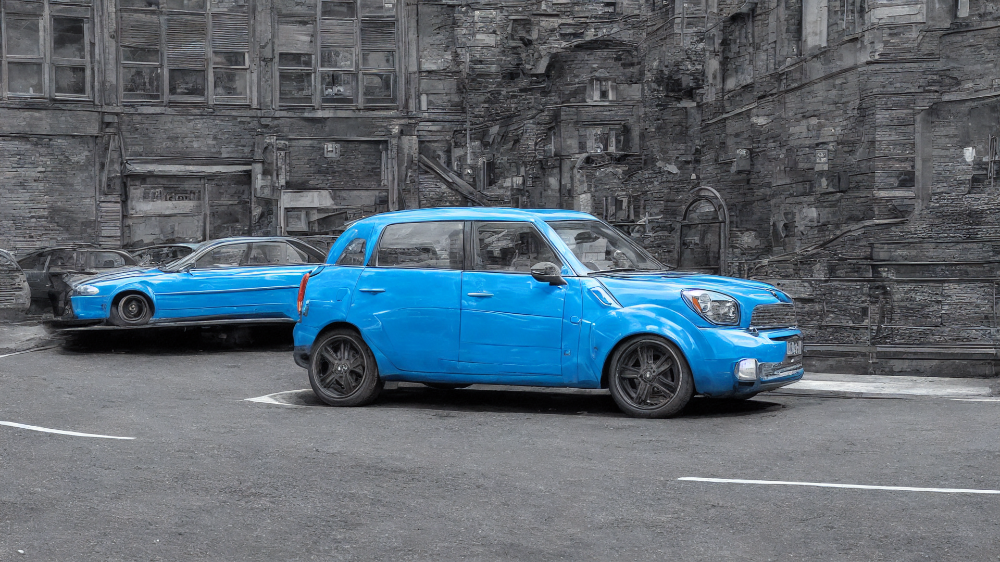

In [ ]:
image_controlNet

In [ ]:
# Instruct pix2pix

In [ ]:
model_id = "timbrooks/instruct-pix2pix"
IP2P_pipe = StableDiffusionInstructPix2PixPipeline.from_pretrained(model_id, torch_dtype=torch.float16, safety_checker=None)
IP2P_pipe.to("cuda")

Fetching 13 files:   0%|          | 0/13 [00:00<?, ?it/s]

StableDiffusionInstructPix2PixPipeline {
  "_class_name": "StableDiffusionInstructPix2PixPipeline",
  "_diffusers_version": "0.16.1",
  "feature_extractor": [
    "transformers",
    "CLIPImageProcessor"
  ],
  "requires_safety_checker": false,
  "safety_checker": [
    null,
    null
  ],
  "scheduler": [
    "diffusers",
    "EulerAncestralDiscreteScheduler"
  ],
  "text_encoder": [
    "transformers",
    "CLIPTextModel"
  ],
  "tokenizer": [
    "transformers",
    "CLIPTokenizer"
  ],
  "unet": [
    "diffusers",
    "UNet2DConditionModel"
  ],
  "vae": [
    "diffusers",
    "AutoencoderKL"
  ]
}

In [ ]:
InstructPix2piximages = IP2P_pipe("change car color to blue", image=image).images

  0%|          | 0/100 [00:00<?, ?it/s]

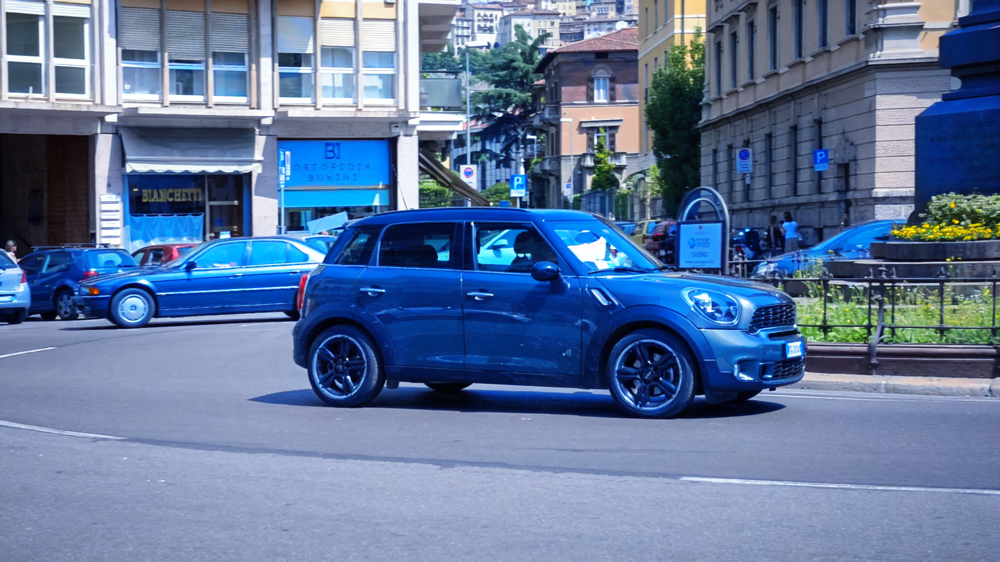

In [ ]:
InstructPix2piximages[0]

In [ ]:
# CLIP-Interogator

In [ ]:
def set_clip_interogtor():
  caption_model_name = 'blip-large' 
  clip_model_name = 'ViT-L-14/openai'
  config = Config()
  config.clip_model_name = clip_model_name
  config.caption_model_name = caption_model_name
  ci = Interrogator(config)
  return ci 

def image_to_prompt(image, mode):
    ci.config.chunk_size = 2048 if ci.config.clip_model_name == "ViT-L-14/openai" else 1024
    ci.config.flavor_intermediate_count = 2048 if ci.config.clip_model_name == "ViT-L-14/openai" else 1024
    image = image.convert('RGB')
    if mode == 'best':
        return ci.interrogate(image)
    elif mode == 'classic':
        return ci.interrogate_classic(image)
    elif mode == 'fast':
        return ci.interrogate_fast(image)
    elif mode == 'negative':
        return ci.interrogate_negative(image)

In [ ]:
ci = set_clip_interogtor()

Loading caption model blip-large...


Loading CLIP model ViT-L-14/openai...


100%|████████████████████████████████████████| 933M/933M [00:03<00:00, 241MiB/s]
ViT-L-14_openai_artists.safetensors: 100%|██████████| 16.2M/16.2M [00:00<00:00, 415MB/s]
ViT-L-14_openai_flavors.safetensors: 100%|██████████| 155M/155M [00:00<00:00, 507MB/s]
ViT-L-14_openai_mediums.safetensors: 100%|██████████| 146k/146k [00:00<00:00, 28.4MB/s]
ViT-L-14_openai_movements.safetensors: 100%|██████████| 307k/307k [00:00<00:00, 38.8MB/s]
ViT-L-14_openai_trendings.safetensors: 100%|██████████| 111k/111k [00:00<00:00, 28.2MB/s]
ViT-L-14_openai_negative.safetensors: 100%|██████████| 63.2k/63.2k [00:00<00:00, 27.6MB/s]

Loaded CLIP model and data in 14.63 seconds.


In [ ]:
prompt = image_to_prompt(image, 'best')

100%|██████████| 50/50 [00:00<00:00, 203.36it/s]


In [ ]:
print(prompt)

arafed mini cooper driving down a city street in the daytime, trending on pexels, italy, clean horizon, inspired by Ai-Mitsu, high contrast hyperrealism 8k, iso 125, stealthy, townscape, woman with black hair, toxic air, crosswalk, exhaust smoke, by Jacopo Bellini, niea 7


In [211]:
new_prompt = 'arafed blue mini cooper driving down a city street in the daytime, trending on pexels, italy, clean horizon, inspired by Ai-Mitsu, high contrast hyperrealism 8k, iso 125, stealthy, townscape, woman with black hair, toxic air, crosswalk, exhaust smoke, by Jacopo Bellini, niea 7'

In [212]:
image_controlNet2 = CN_pipe(new_prompt, num_inference_steps=40, generator=CN_generator, image=image_cn).images[0]

  0%|          | 0/40 [00:00<?, ?it/s]

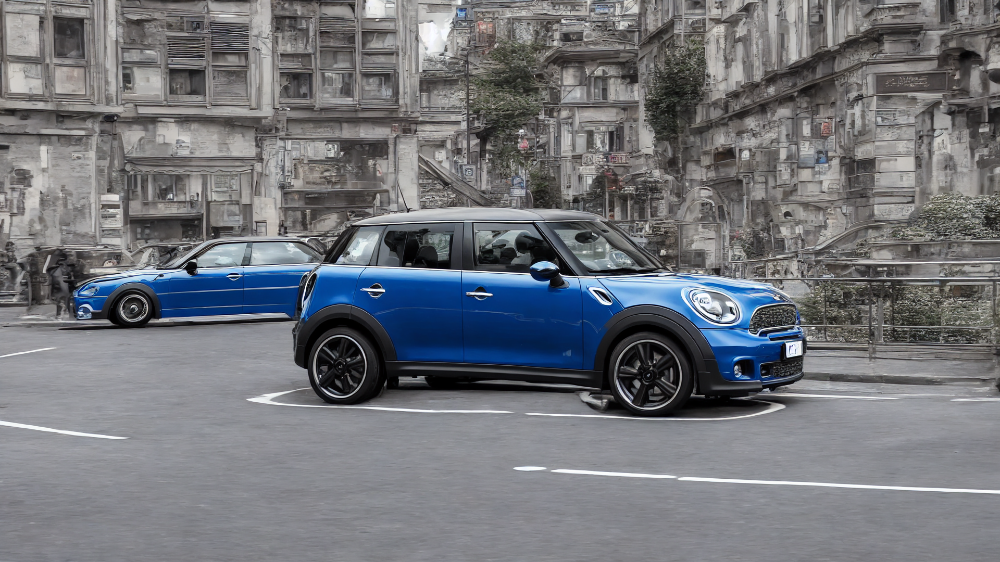

In [213]:
image_controlNet2

In [ ]:
# Segments 

In [ ]:
CHECKPOINT_PATH = '/content/drive/MyDrive/Data/sam_vit_h_4b8939.pth'

In [ ]:
MODEL_TYPE = "vit_h"
sam = sam_model_registry[MODEL_TYPE](checkpoint=CHECKPOINT_PATH)
sam.to(device='cuda')

Sam(
  (image_encoder): ImageEncoderViT(
    (patch_embed): PatchEmbed(
      (proj): Conv2d(3, 1280, kernel_size=(16, 16), stride=(16, 16))
    )
    (blocks): ModuleList(
      (0-31): 32 x Block(
        (norm1): LayerNorm((1280,), eps=1e-06, elementwise_affine=True)
        (attn): Attention(
          (qkv): Linear(in_features=1280, out_features=3840, bias=True)
          (proj): Linear(in_features=1280, out_features=1280, bias=True)
        )
        (norm2): LayerNorm((1280,), eps=1e-06, elementwise_affine=True)
        (mlp): MLPBlock(
          (lin1): Linear(in_features=1280, out_features=5120, bias=True)
          (lin2): Linear(in_features=5120, out_features=1280, bias=True)
          (act): GELU(approximate='none')
        )
      )
    )
    (neck): Sequential(
      (0): Conv2d(1280, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (1): LayerNorm2d()
      (2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (3): LayerNorm2d

In [ ]:
mask_generator = SamAutomaticMaskGenerator(sam)

In [ ]:
image_bgr = cv2.imread(image_path)
image_rgb = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2RGB)

In [ ]:
result = mask_generator.generate(image_rgb)

In [ ]:
mask_annotator = sv.MaskAnnotator()
detections = sv.Detections.from_sam(result)
annotated_image = mask_annotator.annotate(image_bgr, detections)

In [ ]:
segmented_image = Image.fromarray(annotated_image)

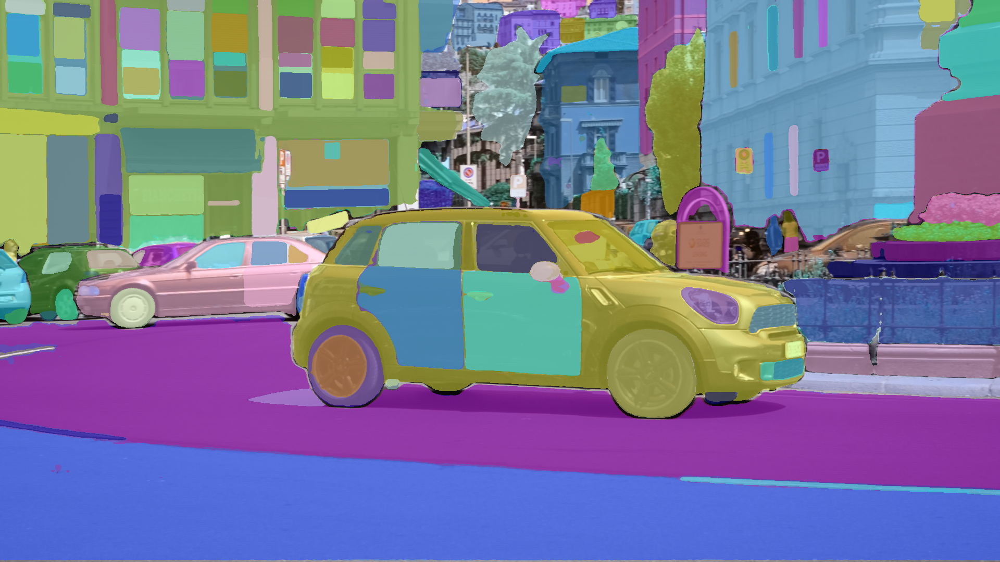

In [ ]:
segmented_image

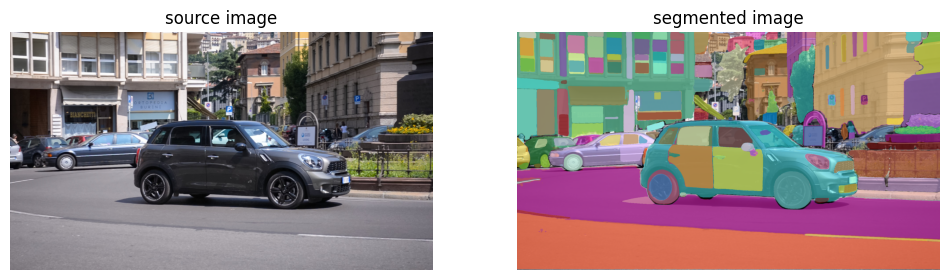

In [ ]:
mask_annotator = sv.MaskAnnotator()

detections = sv.Detections.from_sam(sam_result=result)

annotated_image = mask_annotator.annotate(scene=image_bgr.copy(), detections=detections)

sv.plot_images_grid(
    images=[image_bgr, annotated_image],
    grid_size=(1, 2),
    titles=['source image', 'segmented image']
)

In [ ]:
masks = [ mask['segmentation'] for mask in sorted(result, key=lambda x: x['area'], reverse=True) ]

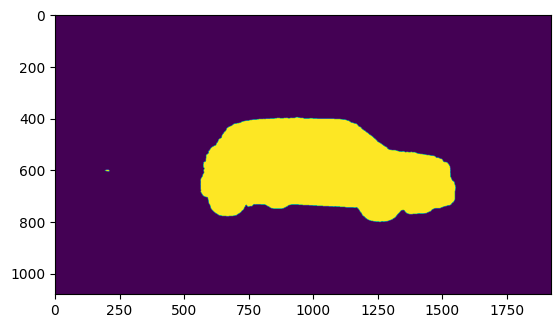

In [ ]:
plt.imshow(masks[6])

In [ ]:
print(masks[6])

[[False False False ... False False False]
 [False False False ... False False False]
 [False False False ... False False False]
 ...
 [False False False ... False False False]
 [False False False ... False False False]
 [False False False ... False False False]]


In [ ]:
# Simple in-painting using Stable diffusion 

In [ ]:
mask_car = np.where(np.expand_dims(masks[6], 2), [255, 255, 255], [0,0,0] ) 

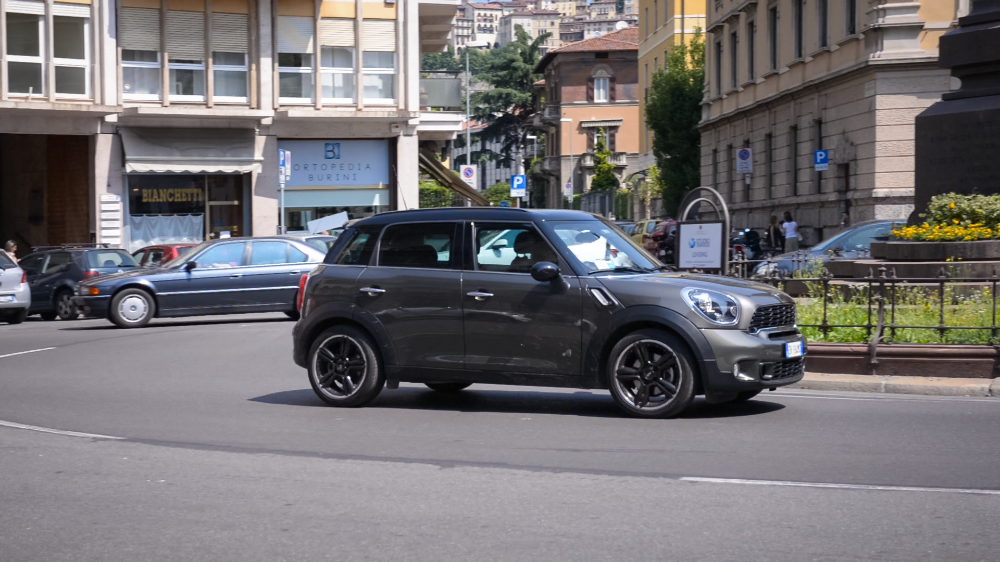

In [ ]:
image

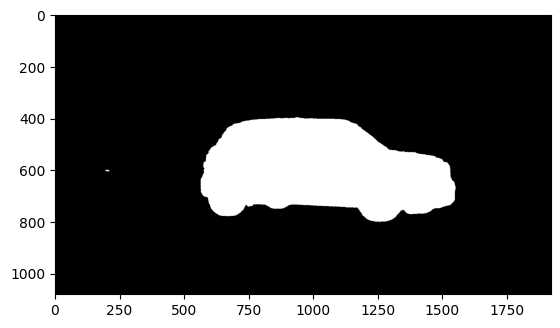

In [ ]:
plt.imshow(mask_car)

In [ ]:
mask_car = Image.fromarray( np.array(mask_car).astype(np.uint8)  ).convert("RGB").resize( (512,512) )

In [ ]:
image_512 = image.resize( (512, 512) )

In [ ]:
sd_pipe = StableDiffusionInpaintPipeline.from_pretrained("runwayml/stable-diffusion-inpainting", torch_dtype=torch.float16).to("cuda")
sd_pipe.enable_attention_slicing()

text_encoder/model.safetensors not found


Fetching 16 files:   0%|          | 0/16 [00:00<?, ?it/s]

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.


In [ ]:
'''
new_prompt = 'arafed blue mini cooper driving down a city street in the daytime, trending on pexels, italy, clean horizon, inspired by Ai-Mitsu, high contrast hyperrealism 8k, iso 125, stealthy, townscape, woman with black hair, toxic air, crosswalk, exhaust smoke, by Jacopo Bellini, niea 7'
'''

In [ ]:
sd_inp_image = sd_pipe(prompt=new_prompt, image=image_512, mask_image=mask_car).images[0]

  0%|          | 0/50 [00:00<?, ?it/s]

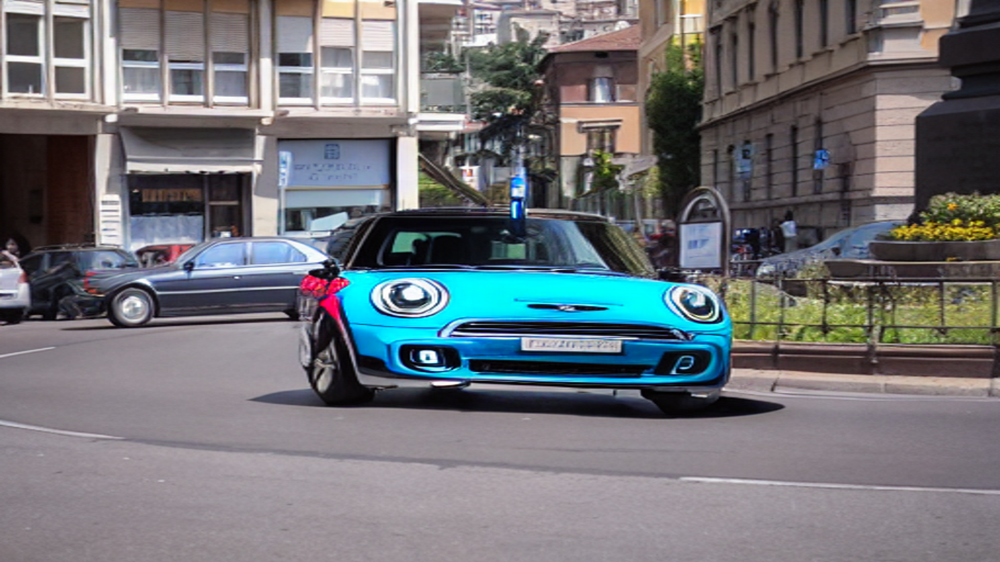

In [ ]:
sd_inp_image.resize( (1920, 1080) )

In [ ]:
! git clone https://github.com/mikonvergence/ControlNetInpaint
import sys
sys.path.append('./ControlNetInpaint/')

Cloning into 'ControlNetInpaint'...
remote: Enumerating objects: 79, done.
remote: Counting objects: 100% (79/79), done.
remote: Compressing objects: 100% (65/65), done.
remote: Total 79 (delta 29), reused 51 (delta 13), pack-reused 0
Unpacking objects: 100% (79/79), 15.05 MiB | 10.44 MiB/s, done.


In [ ]:
from diffusers import StableDiffusionInpaintPipeline, ControlNetModel, UniPCMultistepScheduler
from src.pipeline_stable_diffusion_controlnet_inpaint import *

In [ ]:
controlnet = ControlNetModel.from_pretrained("lllyasviel/sd-controlnet-canny", torch_dtype=torch.float16)
pipeCN_inp = StableDiffusionControlNetInpaintPipeline.from_pretrained(
     "runwayml/stable-diffusion-inpainting", controlnet=controlnet, torch_dtype=torch.float16
 )

# speed up diffusion process with faster scheduler and memory optimization
pipeCN_inp.scheduler = UniPCMultistepScheduler.from_config(pipeCN_inp.scheduler.config)

pipeCN_inp.to('cuda')

# generate image
generator = torch.manual_seed(555)


new_image = pipeCN_inp(
    new_prompt,
    num_inference_steps=50,
    generator=generator,
    image=image_512,
    control_image=image_cn.resize( (512, 512) ),
    mask_image=mask_car).images[0]

text_encoder/model.safetensors not found
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.


  0%|          | 0/50 [00:00<?, ?it/s]

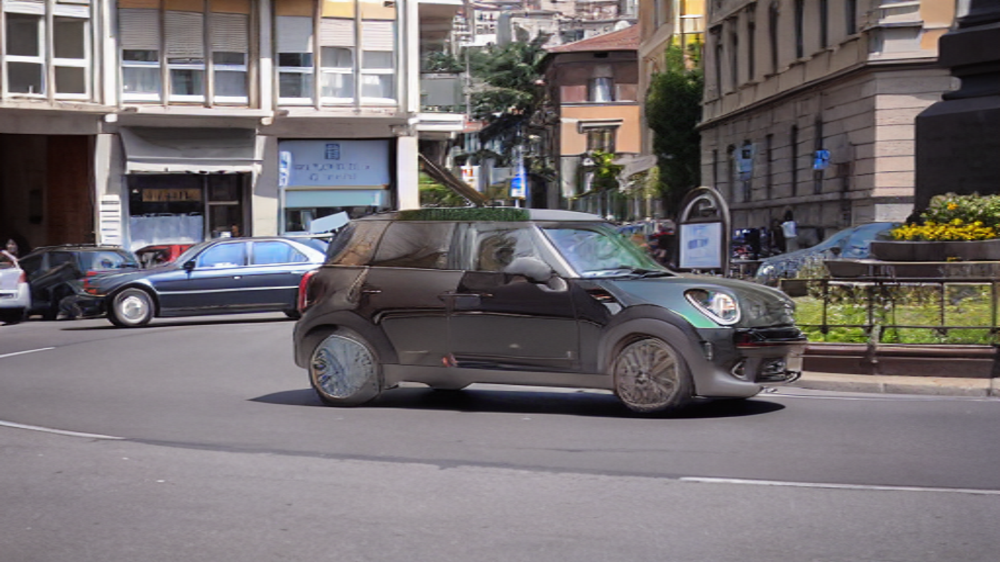

In [ ]:
new_image.resize( (1920, 1080) )

In [ ]:
# remove car 

In [ ]:
new_prompt_remove = 'a city street in the daytime'

In [ ]:
new_image_remove = pipeCN_inp(
    new_prompt_remove,
    num_inference_steps=50,
    generator=generator,
    image=image_512,
    control_image=image_cn.resize( (512, 512) ),
    mask_image=mask_car).images[0]

  0%|          | 0/50 [00:00<?, ?it/s]

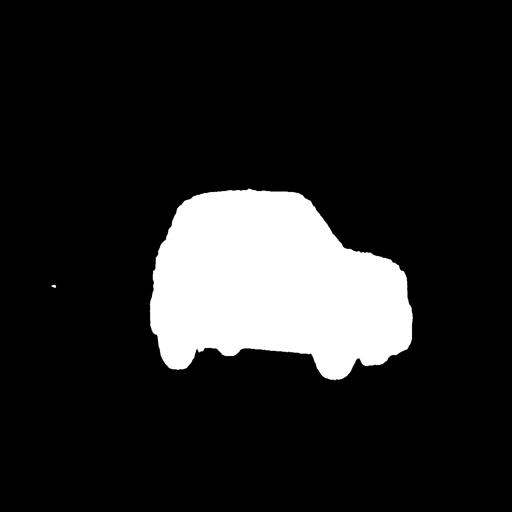

In [202]:
mask_car

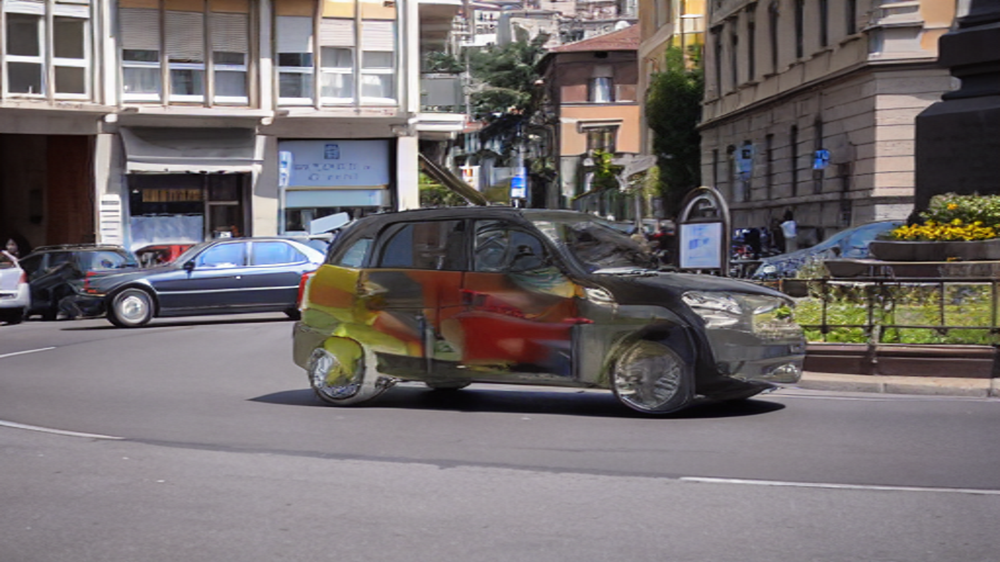

In [ ]:
new_image_remove.resize( (1920, 1080) )

In [163]:
sd_inp_image_remove = sd_pipe(image=image_512, mask_image=mask_car, guidance_scale=5.5, prompt="roundabout, concrete, street, no cars, nothing", num_inference_steps=30).images[0]

  0%|          | 0/30 [00:00<?, ?it/s]

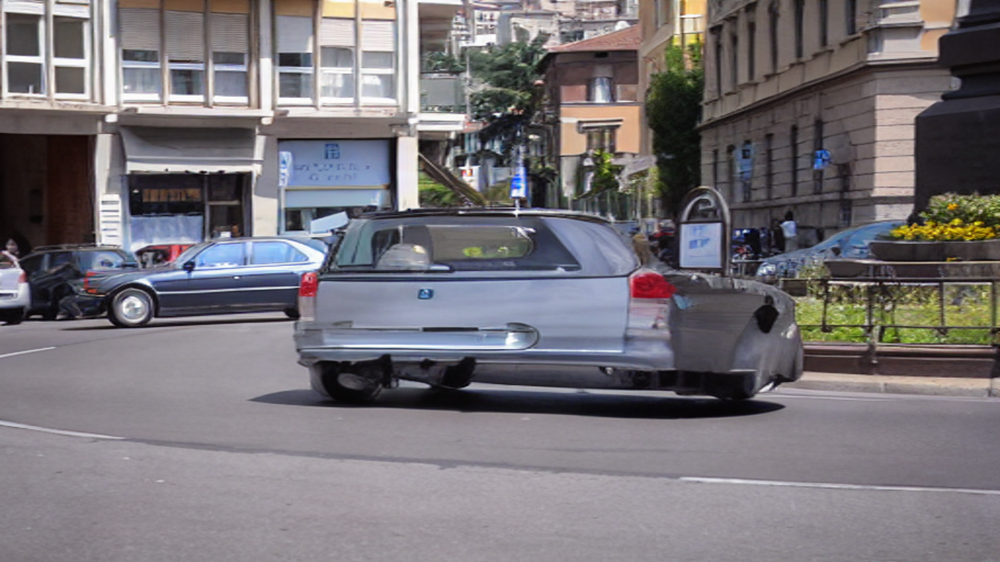

In [164]:
sd_inp_image_remove.resize( (1920, 1080) )

In [165]:
tmp_img_ = np.array(sd_inp_image_remove.resize( (1920, 1080) ) )

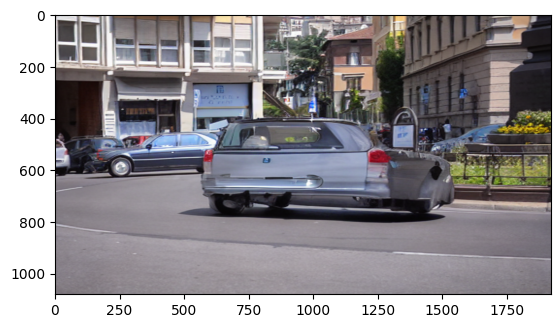

In [166]:
plt.imshow(tmp_img_)

In [ ]:
left_mask = final_mask_tmp[:, :512]
right_mask = final_mask_tmp[:, frame_tmp[1]-512:]

In [ ]:
# Create masks for all video frames 

In [192]:
left_patch = np.ones( (600, 520, 3 ), dtype=np.uint8 ) * 1
center = np.ones( (600, 1000, 3 ), dtype=np.uint8 ) * 255
right_patch = np.ones( (600, 400, 3 ), dtype=np.uint8 ) * 1

In [193]:
top = np.ones( ( int((1080-600)/2), 1920, 3 ), dtype=np.uint8 ) * 1
bottom = np.ones( ( int((1080-600)/2), 1920, 3),  dtype=np.uint8 ) * 1

In [194]:
mask = np.concatenate( (left_patch, center, right_patch), axis=1) 

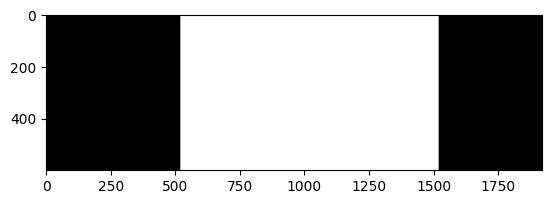

In [195]:
plt.imshow(mask)

In [196]:
mask = np.concatenate( (top, mask, bottom), axis=0) 

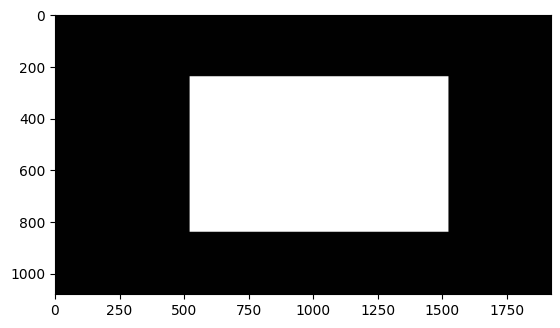

In [197]:
plt.imshow(mask)

In [198]:
mask_img = Image.fromarray(mask, 'RGB')

In [199]:
mask_img = mask_img.resize( (512, 512) )

In [209]:
sd_inp_image_remove = sd_pipe(image=image_512, mask_image=mask_img, guidance_scale=7.5, prompt="roundabout, concrete, street, no cars, nothing", num_inference_steps=30).images[0]

  0%|          | 0/30 [00:00<?, ?it/s]

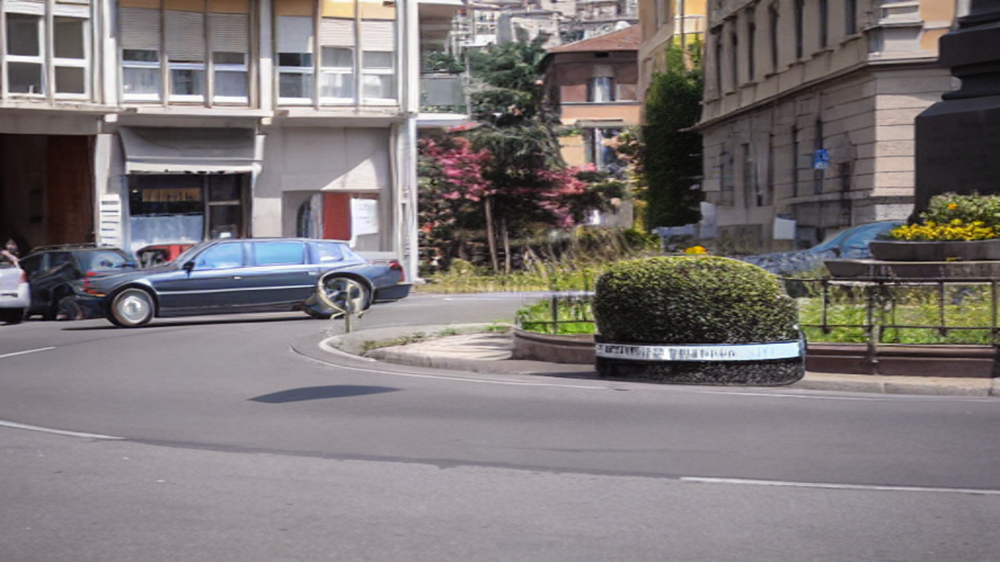

In [210]:
sd_inp_image_remove.resize( (1920, 1080) )